## **Connecting to Google Drive**

In [ ]:
# Import the drive module from google.colab to mount Google Drive
from google.colab import drive

# Mount Google Drive to the Colab environment
# This will prompt you to authorize access to your Google Drive account
drive.mount('/content/drive')

# Define the path to the training dataset located in Google Drive
data_root = '/content/drive/MyDrive/animal/Train'

# Define the path to the test dataset located in Google Drive
data_test = '/content/drive/MyDrive/animal/Test'


Mounted at /content/drive


## **Python Liabrires**

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

import cv2
import os
os.environ["TF_CPP_MIN_LOG_LEVEL"] = "2"
import warnings
warnings.filterwarnings('ignore')

from sklearn.metrics import confusion_matrix, classification_report, precision_recall_fscore_support
from sklearn.utils import class_weight

import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Activation, BatchNormalization, Conv2D, Dense, Dropout, Flatten, MaxPooling2D
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras import layers, models , regularizers, optimizers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import CategoricalCrossentropy
from tensorflow.keras.regularizers import l2
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping

from tensorflow.keras.applications import VGG19
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.applications import InceptionV3

## **Data Preprocessing**

In [ ]:
# Define image dimensions and batch size
img_width, img_height = 150, 150
batch_size = 64
Training_data_dir = str(data_root)
Testing_data_dir = str(data_test)

# Data Augmentation for the training set
# The ImageDataGenerator will apply random transformations to the training images
# This helps in reducing overfitting and improving the model's generalization
train_datagen = ImageDataGenerator(
    rotation_range=10,
    rescale=1.0/255,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest')

validation_datagen = ImageDataGenerator(rescale=1.0/255,validation_split=.20)
test_datagen = ImageDataGenerator(rescale=1.0/255)


# Data generator for the training set
train_generator = train_datagen.flow_from_directory(
    Training_data_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    subset="training",
    class_mode='categorical',
    shuffle=True)

# Data generator for the validation set
validation_generator = validation_datagen.flow_from_directory(
    Training_data_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    subset="validation",
    class_mode='categorical',
    shuffle=True)

# Data generator for the test set
test_generator = test_datagen.flow_from_directory(
    Testing_data_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False)

# Map class indices to their respective class labels
labels = {value: key for key, value in train_generator.class_indices.items()}

# Print the label mappings to understand which index corresponds to which class
print("Label Mappings for classes present in the training and validation datasets\n")
for key, value in labels.items():
    print(f"{key} : {value}")


Found 5964 images belonging to 6 classes.
Found 1191 images belonging to 6 classes.
Found 759 images belonging to 6 classes.
Label Mappings for classes present in the training and validation datasets

0 : Cheetah
1 : Elephant
2 : Giraffe
3 : Lion
4 : Rhino
5 : Zebra


 This cell sets up the image preprocessing and data augmentation pipeline. It configures ImageDataGenerator to apply transformations to training images (e.g., rotation, scaling, flipping) for better generalization. It then creates data generators for training, validation, and testing datasets, allowing efficient loading and preprocessing.

## **Class Weight**

In [ ]:
# Calculate class weights to handle class imbalance
# This ensures that classes with fewer samples are given higher weight during training
# 'balanced' mode uses the formula: n_samples / (n_classes * np.bincount(y))
class_weights = class_weight.compute_class_weight(
    class_weight='balanced',
    classes=np.unique(train_generator.classes),
    y=train_generator.classes
)

# Convert class weights to a dictionary format required by Keras
class_weights_dict = {i: class_weights[i] for i in range(len(class_weights))}
print("Class Weights:", class_weights_dict)

Class Weights: {0: 1.1721698113207548, 1: 1.0463157894736843, 2: 1.004040404040404, 3: 0.9851337958374629, 4: 0.9019963702359347, 5: 0.9333333333333333}


## **Visualization**

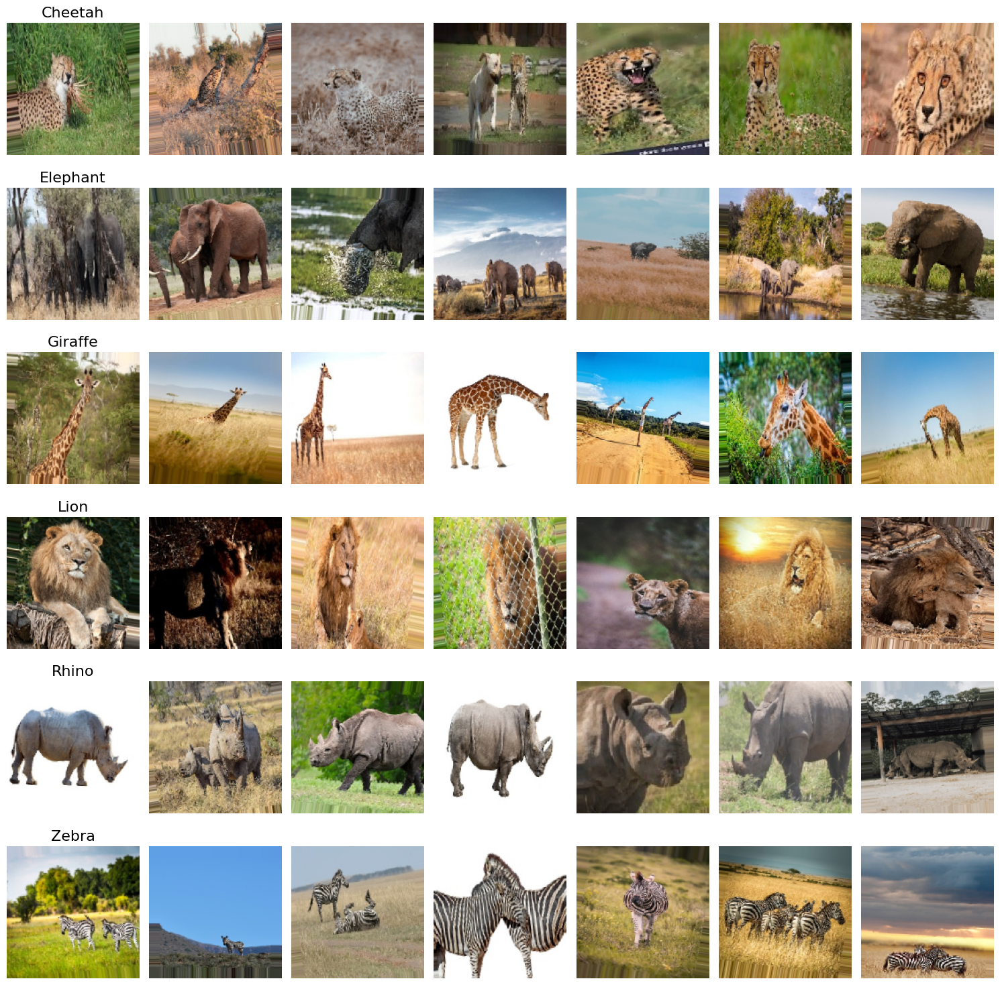

In [ ]:
# Function to plot images in a grid
def plot_images(images, labels, class_names, num_classes, num_images_per_class):
    fig, axes = plt.subplots(num_classes, num_images_per_class, figsize=(15, 15))

    for i in range(num_classes):
        class_images = images[labels == i][:num_images_per_class]
        for j in range(num_images_per_class):
            if j < len(class_images):
                axes[i, j].imshow(class_images[j])
            axes[i, j].axis('off')
            if j == 0:
                axes[i, j].set_title(class_names[i], fontsize=16)

    plt.tight_layout()
    plt.show()

# Extract a batch of images and their labels from the generator
num_classes = len(labels)
num_images_per_class = 7
all_images = []
all_labels = []

# Iterate through the data until we have enough images for each class
for _ in range(int(np.ceil(num_classes * num_images_per_class / batch_size))):
    images, image_labels = next(train_generator)
    all_images.append(images)
    all_labels.append(image_labels)

# Concatenate all images and labels
all_images = np.concatenate(all_images)
all_labels = np.concatenate(all_labels)

# Convert one-hot labels to class indices
all_labels = np.argmax(all_labels, axis=1)

# Get class names
class_names = [labels[i] for i in range(num_classes)]

# Plot the images
plot_images(all_images, all_labels, class_names, num_classes, num_images_per_class)


## **Transfer Learning**

### **VGG19**

#### Training

In [ ]:
from tensorflow.keras import layers, models
# Load VGG19 model pre-trained on ImageNet, without the top classification layer
base_model = VGG19(input_shape=(img_width, img_height, 3), include_top=False, weights='imagenet')

# Freeze the base model
base_model.trainable = False

# Add custom layers on top
x = base_model.output
x = layers.GlobalAveragePooling2D()(x)
x = layers.Dense(512, activation='relu')(x)
x = layers.Dropout(0.5)(x)
predictions = layers.Dense(train_generator.num_classes, activation='softmax')(x)

# Define the model
VGG19_model = models.Model(inputs=base_model.input, outputs=predictions)
print(VGG19_model.summary())

Early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
optimizer = Adam(learning_rate=0.001)
VGG19_model.compile(optimizer=optimizer, loss=CategoricalCrossentropy(), metrics=['accuracy'])


# Train the model with class weights
VGG19_history = VGG19_model.fit(
    train_generator,
    epochs=35,
    validation_data=validation_generator,
    verbose=2,
    callbacks=[Early_stopping],
    class_weight=class_weights_dict
)

80134624/80134624 ━━━━━━━━━━━━━━━━━━━━ 3s 0us/step


Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_2 (InputLayer)           │ (None, 150, 150, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 150, 150, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 150, 150, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 75, 75, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 75, 75, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 75, 75, 128)         │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 37, 37, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 37, 37, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 37, 37, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 37, 37, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv4 (Conv2D)                │ (None, 37, 37, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 18, 18, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 18, 18, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 18, 18, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 18, 18, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv4 (Conv2D)                │ (None, 18, 18, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 9, 9, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 9, 9, 512)           │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 9, 9, 512)           │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 9, 9, 512)           │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv4 (Conv2D)                │ (None, 9, 9, 512)           │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼──────────────

 Total params: 20,290,118 (77.40 MB)

 Trainable params: 265,734 (1.01 MB)

 Non-trainable params: 20,024,384 (76.39 MB)

None
Epoch 1/35
103/103 - 91s - 885ms/step - accuracy: 0.5560 - loss: 1.1854 - val_accuracy: 0.7414 - val_loss: 0.7306
Epoch 2/35
103/103 - 53s - 515ms/step - accuracy: 0.6864 - loss: 0.8526 - val_accuracy: 0.7925 - val_loss: 0.6176
Epoch 3/35
103/103 - 53s - 512ms/step - accuracy: 0.7216 - loss: 0.7657 - val_accuracy: 0.8024 - val_loss: 0.5606
Epoch 4/35
103/103 - 53s - 515ms/step - accuracy: 0.7334 - loss: 0.7242 - val_accuracy: 0.8230 - val_loss: 0.5092
Epoch 5/35
103/103 - 52s - 509ms/step - accuracy: 0.7470 - loss: 0.6903 - val_accuracy: 0.8207 - val_loss: 0.5020
Epoch 6/35
103/103 - 52s - 509ms/step - accuracy: 0.7586 - loss: 0.6730 - val_accuracy: 0.8398 - val_loss: 0.4747
Epoch 7/35
103/103 - 53s - 513ms/step - accuracy: 0.7701 - loss: 0.6381 - val_accuracy: 0.8299 - val_loss: 0.4606
Epoch 8/35
103/103 - 52s - 508ms/step - accuracy: 0.7743 - loss: 0.6227 - val_accuracy: 0.8505 - val_loss: 0.4339
Epoch 9/35
103/103 - 52s - 509ms/step - accuracy: 0.7770 - loss: 0.6151 - val_accur

#### Evaluation

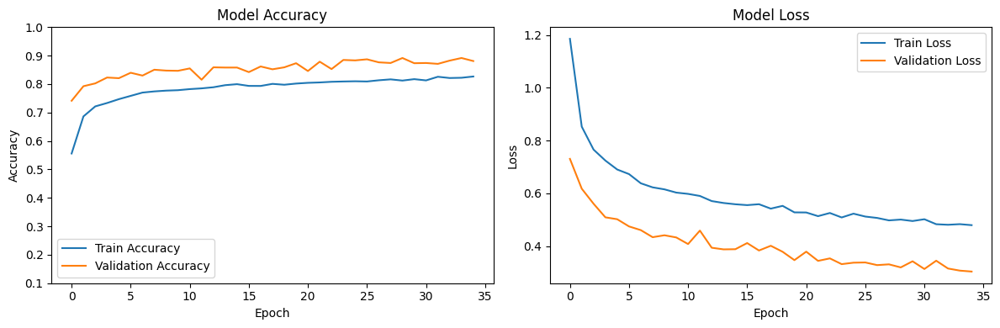

--------------------------------------------------------------------------------------------------
Results for Pre-Trained Model - VGG19:
103/103 ━━━━━━━━━━━━━━━━━━━━ 50s 476ms/step
103/103 ━━━━━━━━━━━━━━━━━━━━ 48s 469ms/step - accuracy: 0.8575 - loss: 0.4077
Training Loss:     0.4036674499511719
Training Accuracy: 0.8575780391693115
--------------------------------------------------------------------------------------------------
21/21 ━━━━━━━━━━━━━━━━━━━━ 4s 185ms/step
21/21 ━━━━━━━━━━━━━━━━━━━━ 4s 178ms/step - accuracy: 0.8821 - loss: 0.2996
Validation Loss:     0.30370524525642395
Validation Accuracy: 0.8810068368911743
--------------------------------------------------------------------------------------------------
12/12 ━━━━━━━━━━━━━━━━━━━━ 442s 40s/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 3s 251ms/step - accuracy: 0.8391 - loss: 0.4162
Test Loss:     0.4214933216571808
Test Accuracy: 0.8335517644882202
----------------------------------------------------------------------------
Precisio

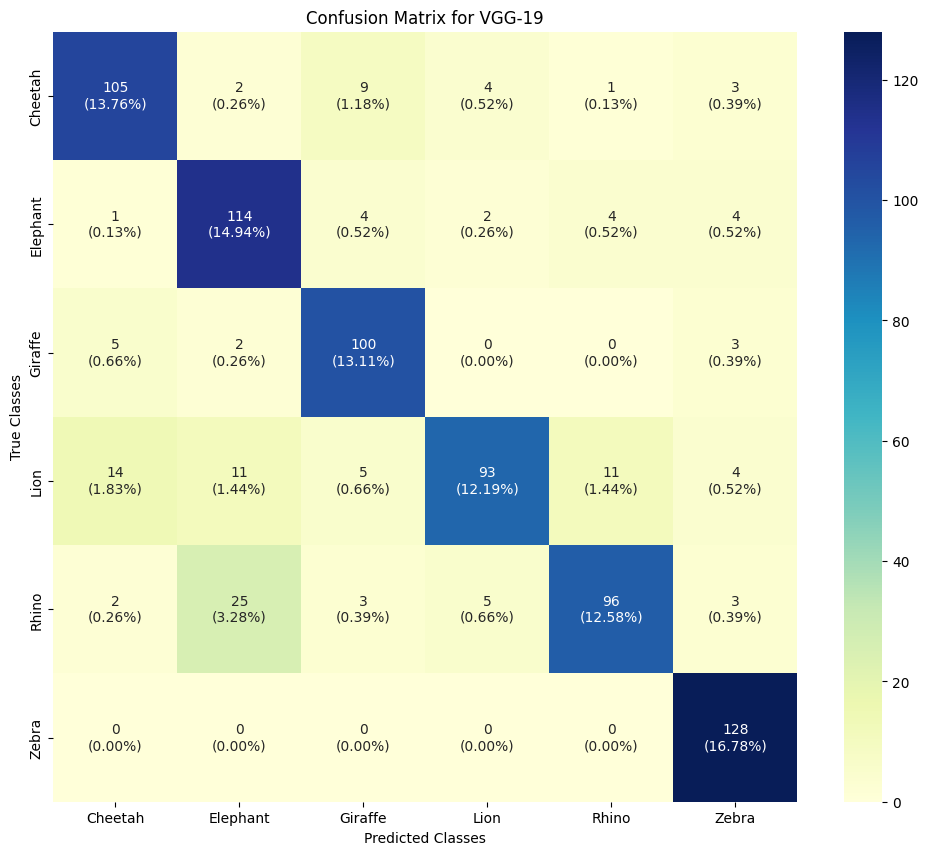

In [ ]:
# Extract the history data
history = VGG19_history.history

# Plot training & validation accuracy values
plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.plot(history['accuracy'], label='Train Accuracy')
plt.plot(history['val_accuracy'], label='Validation Accuracy')
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='best')
plt.yticks([0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1])

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history['loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='best')

# Show the plots
plt.tight_layout()
plt.show()


print("--------------------------------------------------------------------------------------------------")
print("Results for Pre-Trained Model - VGG19:")
## Calculating Training loss and accuracy.
predictions = VGG19_model.predict(train_generator)
train_loss, train_accuracy = VGG19_model.evaluate(train_generator, batch_size=batch_size)
print(f"Training Loss:     {train_loss}")
print(f"Training Accuracy: {train_accuracy}")
print("--------------------------------------------------------------------------------------------------")

# Calculating Validation loss and accuracy.
predictions = VGG19_model.predict(validation_generator)
Validation_loss, Validation_accuracy = VGG19_model.evaluate(validation_generator, batch_size=batch_size)
print(f"Validation Loss:     {Validation_loss}")
print(f"Validation Accuracy: {Validation_accuracy}")
print("--------------------------------------------------------------------------------------------------")

predictions = VGG19_model.predict(test_generator)
test_loss, test_accuracy = VGG19_model.evaluate(test_generator, batch_size=batch_size)
print(f"Test Loss:     {test_loss}")
print(f"Test Accuracy: {test_accuracy}")
print("----------------------------------------------------------------------------")

y_pred = np.argmax(predictions, axis=1)
y_true = test_generator.classes

## Calculating Precision, recall and F1-score.
precision, recall, f1_score, _ = precision_recall_fscore_support(y_true, y_pred, average='weighted')
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"F1 Score: {f1_score}")
print("--------------------------------------------------------------------------------------------------")

## Classification Report
print(classification_report(y_true, y_pred, target_names=labels.values()))
print("----------------------------------------------------------------------------")

## Plotting Confusion Matrix
cf_mtx = confusion_matrix(y_true, y_pred)

group_counts = ["{0:0.0f}".format(value) for value in cf_mtx.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in cf_mtx.flatten()/np.sum(cf_mtx)]
box_labels = [f"{v1}\n({v2})" for v1, v2 in zip(group_counts, group_percentages)]
box_labels = np.asarray(box_labels).reshape(6, 6)
plt.figure(figsize = (12, 10))
sns.heatmap(cf_mtx, xticklabels=labels.values(), yticklabels=labels.values(),
           cmap="YlGnBu", fmt="", annot=box_labels)
plt.title("Confusion Matrix for VGG-19")
plt.xlabel('Predicted Classes')
plt.ylabel('True Classes')
plt.show()

2/2 ━━━━━━━━━━━━━━━━━━━━ 11s 64ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 8s 8s/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


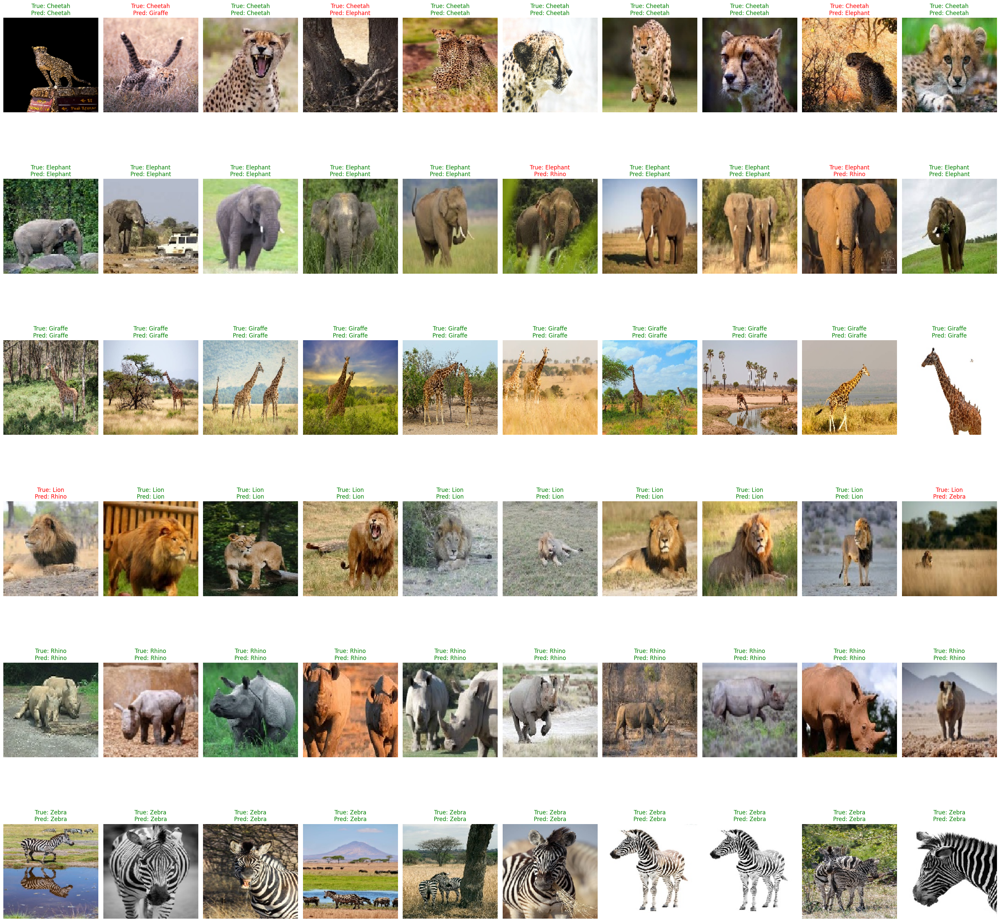

In [ ]:
def display_predictions_per_class(model, generator, class_labels, num_images_per_class=8):
    # Initialize lists to collect images, true classes, and predicted classes for each species
    image_batch = {label: [] for label in class_labels}
    true_classes_batch = {label: [] for label in class_labels}
    predicted_classes_batch = {label: [] for label in class_labels}

    # Number of classes
    num_classes = len(class_labels)

    # Continue extracting batches until we have enough images for each class
    while any(len(images) < num_images_per_class for images in image_batch.values()):
        images, labels = next(generator)
        true_classes = np.argmax(labels, axis=1)
        predictions = model.predict(images)
        predicted_classes = np.argmax(predictions, axis=1)

        for i in range(len(images)):
            true_label = class_labels[true_classes[i]]
            if len(image_batch[true_label]) < num_images_per_class:
                image_batch[true_label].append(images[i])
                true_classes_batch[true_label].append(true_classes[i])
                predicted_classes_batch[true_label].append(predicted_classes[i])

    # Plotting the images in a grid with their true and predicted labels
    plt.figure(figsize=(30, num_classes * 5))

    image_count = 0
    for idx, label in enumerate(class_labels):
        for i in range(num_images_per_class):
            image_count += 1
            ax = plt.subplot(num_classes, num_images_per_class, image_count)
            plt.imshow(image_batch[label][i])

            true_label = class_labels[true_classes_batch[label][i]]
            predicted_label = class_labels[predicted_classes_batch[label][i]]
            color = "green" if true_label == predicted_label else "red"

            plt.title(f"True: {true_label}\nPred: {predicted_label}", color=color)
            plt.axis("off")

    plt.tight_layout()
    plt.show()

# Display predictions for 10 images of each class from the test generator
class_labels = list(test_generator.class_indices.keys())
display_predictions_per_class(VGG19_model, test_generator, class_labels, num_images_per_class=10)


### **ResNet50**

#### Training

In [ ]:

# Load ResNet50 model pre-trained on ImageNet, without the top classification layer
base_model = ResNet50(input_shape=(img_width, img_height, 3), include_top=False, weights='imagenet')

# Unfreeze some layers of the base model
base_model.trainable = True
fine_tune_at = 100

for layer in base_model.layers[:fine_tune_at]:
    layer.trainable = False

# Add custom layers on top
x = base_model.output
x = layers.GlobalAveragePooling2D()(x)
x = layers.Dense(2048, activation='relu', kernel_regularizer=regularizers.l2(0.01))(x)
x = layers.Dropout(0.5)(x)
x = layers.Dense(1024, activation='relu', kernel_regularizer=regularizers.l2(0.01))(x)
x = layers.Dropout(0.5)(x)
predictions = layers.Dense(train_generator.num_classes, activation='softmax')(x)

# Define the model
ResNet50_model = models.Model(inputs=base_model.input, outputs=predictions)
print(ResNet50_model.summary())

Early_stopping = EarlyStopping(monitor='val_loss', patience=14, restore_best_weights=True)
optimizer = Adam(learning_rate=0.001)
ResNet50_model.compile(optimizer=optimizer, loss=CategoricalCrossentropy(), metrics=['accuracy'])


ResNet50_history = ResNet50_model.fit(
    train_generator,
    epochs=40,
    validation_data=validation_generator,
    verbose=2,
    callbacks=[Early_stopping],
    class_weight=class_weights_dict
    )

Model: "functional_10"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_10            │ (None, 150, 150, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_pad (ZeroPadding2D) │ (None, 156, 156, 3)    │              0 │ input_layer_10[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_conv (Conv2D)       │ (None, 75, 75, 64)     │          9,472 │ conv1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_bn                  │ (None, 75, 75, 64)     │            256 │ conv1_conv[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_relu (Activation)   │ (None, 75, 75, 64)     │              0 │ conv1_bn[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pad (ZeroPadding2D) │ (None, 77, 77, 64)     │              0 │ conv1_relu[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pool (MaxPooling2D) │ (None, 38, 38, 64)     │              0 │ pool1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_conv       │ (None, 38, 38, 64)     │          4,160 │ pool1_pool[0][0]       │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_bn         │ (None, 38, 38, 64)     │            256 │ conv2_block1_1_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_relu       │ (None, 38, 38, 64)     │              0 │ conv2_block1_1_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_conv       │ (None, 38, 38, 64)     │         36,928 │ conv2_block1_1_relu[0… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_bn         │ (None, 38, 38, 64)     │            256 │ conv2_block1_2_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_relu       │ (None, 38, 38, 64)     │              0 │ conv2_block1_2_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_0_conv       │ (None, 38, 38, 256)    │         16,640 │ pool1_pool[0][0]       │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_3_conv       │ (None, 38, 38, 256)    │         16,640 │ conv2_block1_2_relu[0… │
│ (Conv2D)             

 Total params: 29,888,390 (114.02 MB)

 Trainable params: 25,753,606 (98.24 MB)

 Non-trainable params: 4,134,784 (15.77 MB)

None
Epoch 1/40
83/83 - 92s - 1s/step - accuracy: 0.2561 - loss: 12.0501 - val_accuracy: 0.1831 - val_loss: 20.9765
Epoch 2/40
83/83 - 55s - 665ms/step - accuracy: 0.3406 - loss: 2.1946 - val_accuracy: 0.2914 - val_loss: 4.1587
Epoch 3/40
83/83 - 54s - 656ms/step - accuracy: 0.3691 - loss: 1.6027 - val_accuracy: 0.3173 - val_loss: 5.0533
Epoch 4/40
83/83 - 55s - 660ms/step - accuracy: 0.3886 - loss: 1.4816 - val_accuracy: 0.2220 - val_loss: 23.9584
Epoch 5/40
83/83 - 55s - 658ms/step - accuracy: 0.4044 - loss: 1.4086 - val_accuracy: 0.1602 - val_loss: 35.9345
Epoch 6/40
83/83 - 54s - 654ms/step - accuracy: 0.4497 - loss: 1.3528 - val_accuracy: 0.1602 - val_loss: 42.4852
Epoch 7/40
83/83 - 54s - 651ms/step - accuracy: 0.4506 - loss: 1.3496 - val_accuracy: 0.1907 - val_loss: 19.2176
Epoch 8/40
83/83 - 54s - 652ms/step - accuracy: 0.4795 - loss: 1.2755 - val_accuracy: 0.1632 - val_loss: 32.1456
Epoch 9/40
83/83 - 53s - 643ms/step - accuracy: 0.4644 - loss: 1.3026 - val_accuracy: 0.2212 - 

#### Evaluation

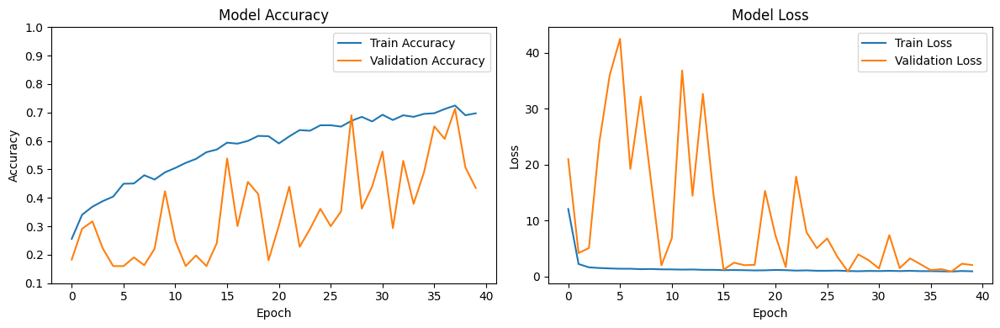

--------------------------------------------------------------------------------------------------
Results for Transfer Model - MobileNetV2:
83/83 ━━━━━━━━━━━━━━━━━━━━ 52s 596ms/step
83/83 ━━━━━━━━━━━━━━━━━━━━ 49s 594ms/step - accuracy: 0.6680 - loss: 0.9603
Training Loss:     0.9419390559196472
Training Accuracy: 0.6697639226913452
--------------------------------------------------------------------------------------------------
17/17 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step
17/17 ━━━━━━━━━━━━━━━━━━━━ 4s 209ms/step - accuracy: 0.6929 - loss: 0.9004
Validation Loss:     0.847843587398529
Validation Accuracy: 0.7131960391998291
--------------------------------------------------------------------------------------------------
10/10 ━━━━━━━━━━━━━━━━━━━━ 4s 354ms/step
10/10 ━━━━━━━━━━━━━━━━━━━━ 4s 371ms/step - accuracy: 0.5464 - loss: 1.3506
Test Loss:     1.1644936800003052
Test Accuracy: 0.6120576858520508
----------------------------------------------------------------------------
Precision: 

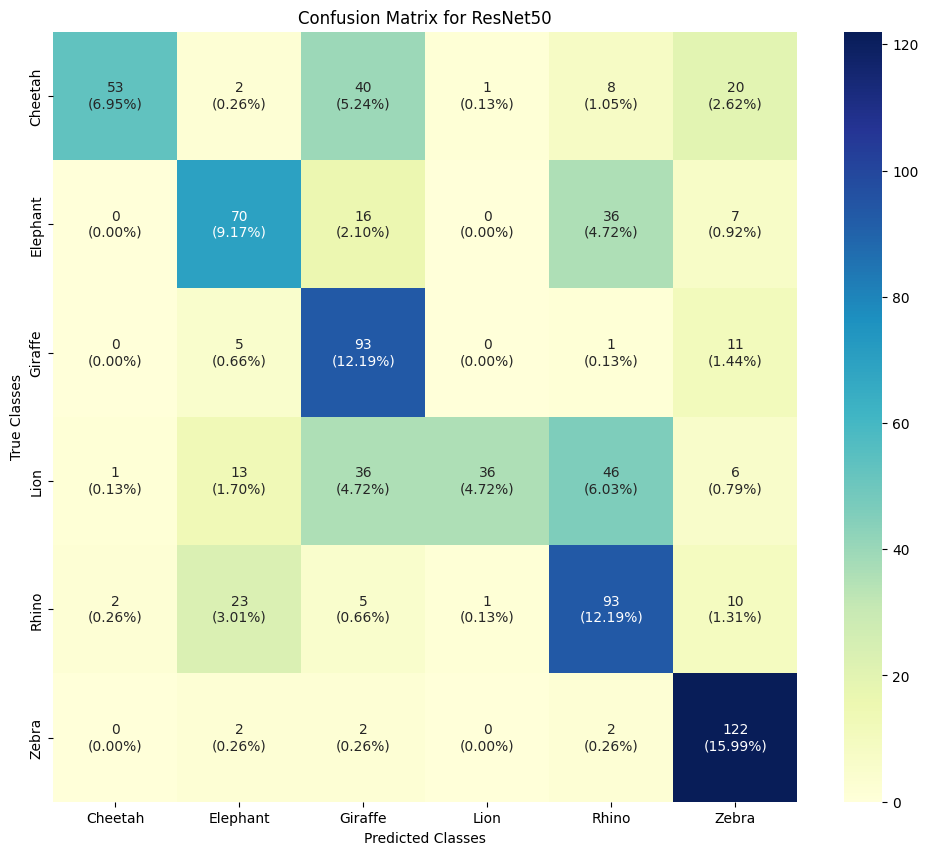

In [ ]:
# Extract the history data
history = ResNet50_history.history

# Plot training & validation accuracy values
plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.plot(history['accuracy'], label='Train Accuracy')
plt.plot(history['val_accuracy'], label='Validation Accuracy')
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='best')
plt.yticks([0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1])

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history['loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='best')

# Show the plots
plt.tight_layout()
plt.show()


print("--------------------------------------------------------------------------------------------------")
print("Results for Transfer Model - MobileNetV2:")
## Calculating Training loss and accuracy.
predictions = ResNet50_model.predict(train_generator)
train_loss, train_accuracy = ResNet50_model.evaluate(train_generator, batch_size=batch_size)
print(f"Training Loss:     {train_loss}")
print(f"Training Accuracy: {train_accuracy}")
print("--------------------------------------------------------------------------------------------------")

# Calculating Validation loss and accuracy.
predictions = ResNet50_model.predict(validation_generator)
Validation_loss, Validation_accuracy = ResNet50_model.evaluate(validation_generator, batch_size=batch_size)
print(f"Validation Loss:     {Validation_loss}")
print(f"Validation Accuracy: {Validation_accuracy}")
print("--------------------------------------------------------------------------------------------------")

predictions = ResNet50_model.predict(test_generator)
test_loss, test_accuracy = ResNet50_model.evaluate(test_generator, batch_size=batch_size)
print(f"Test Loss:     {test_loss}")
print(f"Test Accuracy: {test_accuracy}")
print("----------------------------------------------------------------------------")

y_pred = np.argmax(predictions, axis=1)
y_true = test_generator.classes

## Calculating Precision, recall and F1-score.
precision, recall, f1_score, _ = precision_recall_fscore_support(y_true, y_pred, average='weighted')
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"F1 Score: {f1_score}")
print("--------------------------------------------------------------------------------------------------")

## Classification Report
print(classification_report(y_true, y_pred, target_names=labels.values()))
print("----------------------------------------------------------------------------")

## Plotting Confusion Matrix
cf_mtx = confusion_matrix(y_true, y_pred)

group_counts = ["{0:0.0f}".format(value) for value in cf_mtx.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in cf_mtx.flatten()/np.sum(cf_mtx)]
box_labels = [f"{v1}\n({v2})" for v1, v2 in zip(group_counts, group_percentages)]
box_labels = np.asarray(box_labels).reshape(6, 6)
plt.figure(figsize = (12, 10))
sns.heatmap(cf_mtx, xticklabels=labels.values(), yticklabels=labels.values(),
           cmap="YlGnBu", fmt="", annot=box_labels)
plt.title("Confusion Matrix for ResNet50")
plt.xlabel('Predicted Classes')
plt.ylabel('True Classes')
plt.show()

2/2 ━━━━━━━━━━━━━━━━━━━━ 10s 3s/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


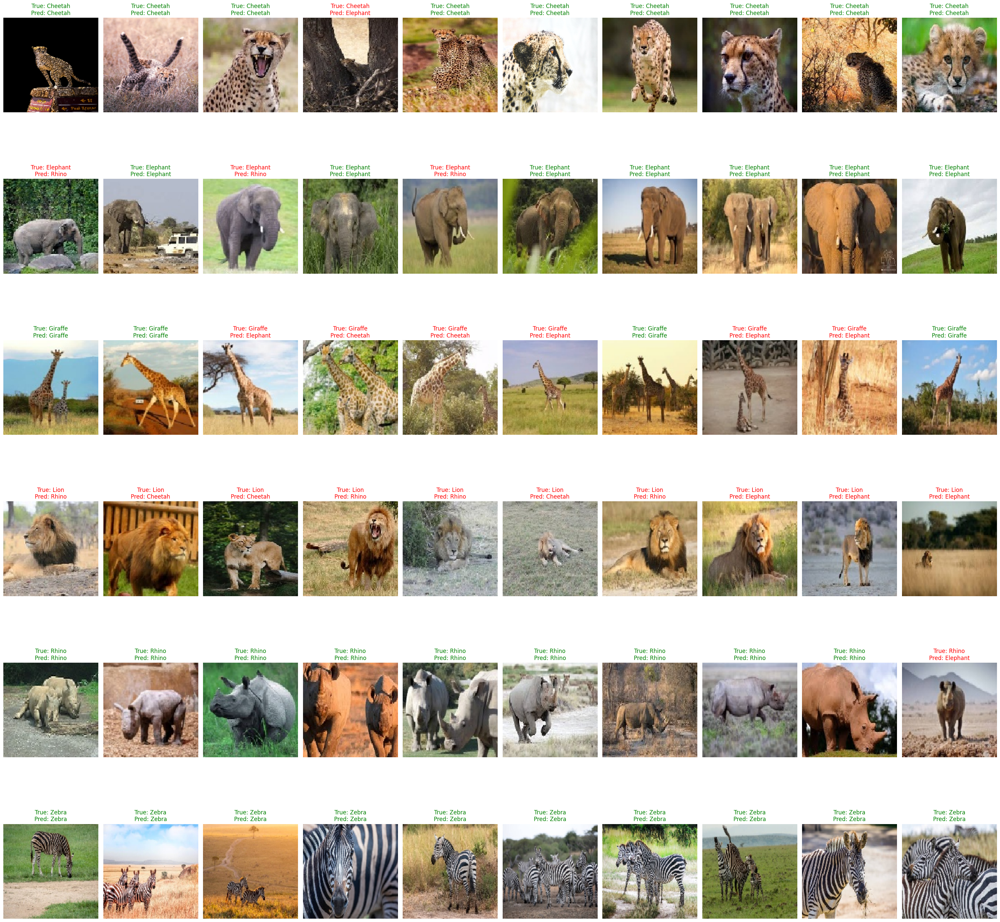

In [ ]:
def display_predictions_per_class(model, generator, class_labels, num_images_per_class=8):
    # Initialize lists to collect images, true classes, and predicted classes for each species
    image_batch = {label: [] for label in class_labels}
    true_classes_batch = {label: [] for label in class_labels}
    predicted_classes_batch = {label: [] for label in class_labels}

    # Number of classes
    num_classes = len(class_labels)

    # Continue extracting batches until we have enough images for each class
    while any(len(images) < num_images_per_class for images in image_batch.values()):
        images, labels = next(generator)
        true_classes = np.argmax(labels, axis=1)
        predictions = model.predict(images)
        predicted_classes = np.argmax(predictions, axis=1)

        for i in range(len(images)):
            true_label = class_labels[true_classes[i]]
            if len(image_batch[true_label]) < num_images_per_class:
                image_batch[true_label].append(images[i])
                true_classes_batch[true_label].append(true_classes[i])
                predicted_classes_batch[true_label].append(predicted_classes[i])

    # Plotting the images in a grid with their true and predicted labels
    plt.figure(figsize=(30, num_classes * 5))

    image_count = 0
    for idx, label in enumerate(class_labels):
        for i in range(num_images_per_class):
            image_count += 1
            ax = plt.subplot(num_classes, num_images_per_class, image_count)
            plt.imshow(image_batch[label][i])

            true_label = class_labels[true_classes_batch[label][i]]
            predicted_label = class_labels[predicted_classes_batch[label][i]]
            color = "green" if true_label == predicted_label else "red"

            plt.title(f"True: {true_label}\nPred: {predicted_label}", color=color)
            plt.axis("off")

    plt.tight_layout()
    plt.show()

# Display predictions for 10 images of each class from the test generator
class_labels = list(test_generator.class_indices.keys())
display_predictions_per_class(ResNet50_model, test_generator, class_labels, num_images_per_class=10)
